In [ ]:
!pip install diffusers transformers accelerate

from diffusers import StableDiffusionPipeline, StableDiffusionImg2ImgPipeline
from PIL import Image
import torch
import os

device = "cuda" if torch.cuda.is_available() else "cpu"
dtype = torch.float16 if device == "cuda" else torch.float32


txt2img_pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=dtype
).to(device)

img2img_pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=dtype
).to(device)


def load_image(path):
    img = Image.open(path).convert("RGB")
    if img.size != (512, 512):
        img = img.resize((512, 512))
    return img

def baseline_identity_only(image_path, save_path):
    img = load_image(image_path)
    img.save(save_path)
    print(f"✅ Saved original image → {save_path}")


def baseline_prompt_only(target_age, gender, save_path):
    prompt = f"a {target_age} year old {gender} person"
    neg_prompt = "blurry, low quality, distorted, extra face parts"

    img = txt2img_pipe(
        prompt=prompt,
        negative_prompt=neg_prompt,
        guidance_scale=7.5,
        num_inference_steps=25
    ).images[0]
    img.save(save_path)
    print(f"✅ Saved prompt-only image → {save_path}")


def baseline_img2img_edit(image_path, target_age, gender, save_path):
    prompt = f"a {target_age} year old {gender} person"
    neg_prompt = "blurry, low quality, distorted, extra eyes"

    init_img = load_image(image_path)

    img = img2img_pipe(
        prompt=prompt,
        image=init_img,
        strength=0.7,
        guidance_scale=7.5,
        negative_prompt=neg_prompt,
        num_inference_steps=25
    ).images[0]
    img.save(save_path)
    print(f"✅ Saved img2img aging → {save_path}")


Defaulting to user installation because normal site-packages is not writeable
  Using cached typing_extensions-4.13.2-py3-none-any.whl (45 kB)
  Attempting uninstall: typing-extensions
    Found existing installation: typing-extensions 4.5.0
    Uninstalling typing-extensions-4.5.0:
      Successfully uninstalled typing-extensions-4.5.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.13.1 requires typing-extensions<4.6.0,>=3.6.6, but you have typing-extensions 4.13.2 which is incompatible.
albumentations 1.4.18 requires numpy>=1.24.4, but you have numpy 1.24.3 which is incompatible.


RuntimeError: Failed to import diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion because of the following error (look up to see its traceback):
Failed to import transformers.models.clip.image_processing_clip because of the following error (look up to see its traceback):
module 'numpy' has no attribute 'typeDict'

In [ ]:
# Example input

img_name = "13_0_2_20170103201143159.jpg"
input_path = f"/{img_name}"
target_age = 45
gender = "male"


os.makedirs("outputs/baselines/identityOnly", exist_ok=True)
os.makedirs("outputs/baselines/promptOnly", exist_ok=True)
os.makedirs("outputs/baselines/imageToImage", exist_ok=True)


baseline_identity_only(input_path, f"outputs/baselines/identityOnly/{img_name}_original.jpg")
baseline_prompt_only(target_age, gender, f"outputs/baselines/promptOnly/{img_name}_prompt_only.jpg")
baseline_img2img_edit(input_path, target_age, gender, f"outputs/baselines/imageToImage/{img_name}_img2img.jpg")


✅ Saved original image → outputs/baselines/identityOnly/13_0_2_20170103201143159.jpg_original.jpg


  0%|          | 0/25 [00:00<?, ?it/s]

✅ Saved prompt-only image → outputs/baselines/promptOnly/13_0_2_20170103201143159.jpg_prompt_only.jpg


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/imageToImage/13_0_2_20170103201143159.jpg_img2img.jpg


🖼️ Original


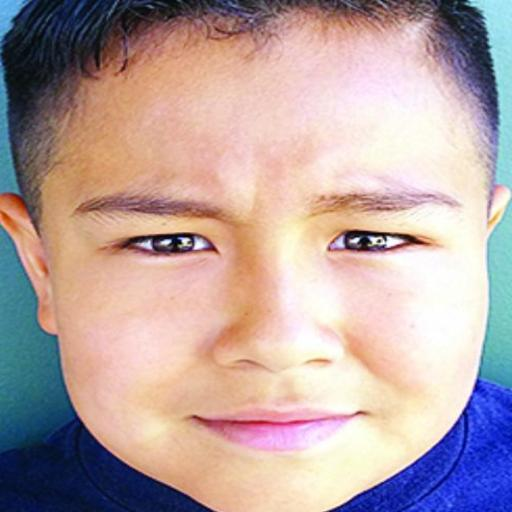

🖼️ Img2Img


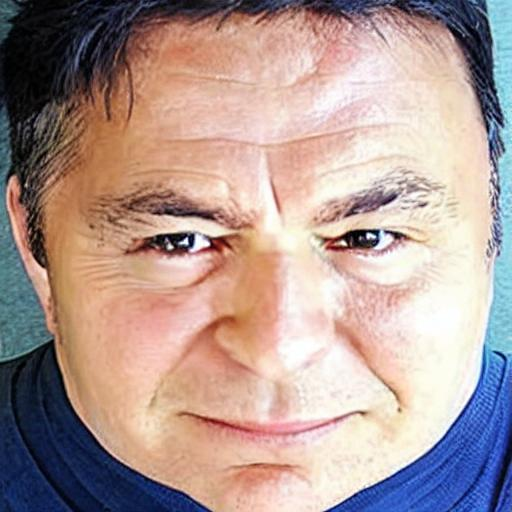

In [ ]:
import os

from IPython.display import display
from PIL import Image

img_name = "13_0_2_20170103201143159.jpg"

base_path = "outputs/baselines"
paths = {
    "Original": f"{base_path}/identityOnly/{img_name}_original.jpg",
    #"PromptOnly": f"{base_path}/promptOnly/{img_name}_prompt_only.jpg",
    "Img2Img": f"{base_path}/imageToImage/{img_name}_img2img.jpg"
}


for label, path in paths.items():
    print(f"🖼️ {label}")
    try:
        img = Image.open(path)
        display(img)
    except FileNotFoundError:
        print(f"❌ File not found: {path}")



In [ ]:
!pip install --quiet diffusers transformers accelerate


from diffusers import StableDiffusionImg2ImgPipeline
import torch
from PIL import Image
import os


device = "cuda" if torch.cuda.is_available() else "cpu"
dtype = torch.float16 if device == "cuda" else torch.float32


pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=dtype,
    safety_checker=None
).to(device)


def load_image(path):
    image = Image.open(path).convert("RGB")
    if image.size != (512, 512):
        image = image.resize((512, 512))
    return image


def simulate_aging(image_path, target_age, gender, output_path=None):
    prompt = f"a {target_age} year old {gender} person"
    negative_prompt = "blurry, low quality, distorted, extra eyes, extra teeth, glasses"

    input_image = load_image(image_path)

    result = pipe(
        prompt=prompt,
        image=input_image,
        strength=0.7,
        guidance_scale=7.5,
        negative_prompt=negative_prompt,
        num_inference_steps=15  # 🔥 Fast + decent quality
    ).images[0]

    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        result.save(output_path)
        print(f"✅ Saved aged image to {output_path}")
    return result


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to aged_outputs/40_to_70.jpg


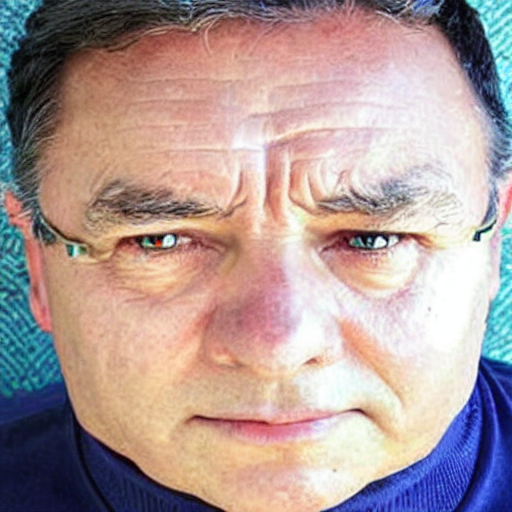

In [ ]:
img_name = "13_0_2_20170103201143159.jpg"
img_path = f"/{img_name}"
simulate_aging(
    image_path="/13_0_2_20170103201143159.jpg",
    target_age=45,
    gender="male",
    output_path="aged_outputs/40_to_70.jpg"
)


In [ ]:
import pandas as pd
import os
import random
from PIL import Image
from IPython.display import display, HTML



def process_batch(start, end, input_csv="utk_train_balanced.csv", output_csv="outputs_part.csv"):
    df = pd.read_csv(input_csv)
    batch_df = df.iloc[start:end]
    rows = []

    for idx, row in batch_df.iterrows():
        original_name = row["filename"]
        gender = row["gender"]
        old_age = int(row["age"])

        # Compute new age(increases age by 5 years)
        min_new_age = old_age + 5
        if min_new_age > 100:
            print(f"⏩ Skipping {original_name} (too old)")
            continue
        new_age = min_new_age

        
        original_path = f"subset150/{original_name}"
        baseline3_name = f"{original_name}_aged_{new_age}.jpg"
        finetuned_name = f"{original_name}_aged_{new_age}.jpg"
        baseline3_path = os.path.join("outputs/baselines", baseline3_name)
        finetuned_path = os.path.join("outputs/finetuned", finetuned_name)

        
        if not os.path.exists(baseline3_path):
            baseline_img2img_edit(original_path, new_age, gender, baseline3_path)
        else:
            print(f"✅ Baseline3 already exists: {baseline3_path}")

        
        if not os.path.exists(finetuned_path):
            simulate_aging(original_path, new_age, gender, finetuned_path)
        else:
            print(f"✅ Finetuned already exists: {finetuned_path}")

        
        print(f"\n🧾 [{idx+1}] {original_name} → aged to {new_age} ({gender})")
        display_images = []
        for label, path in [
            ("Original", original_path),
            ("Baseline3", baseline3_path),
            ("Finetuned", finetuned_path)
        ]:
            try:
                img = Image.open(path).resize((256, 256))
                display_images.append(f'<div style="text-align:center"><img src="{path}" width="256"><br>{label}</div>')
            except Exception as e:
                display_images.append(f'<div style="text-align:center"><b>❌ Missing</b><br>{label}</div>')

        display(HTML(f'<div style="display:flex; gap:15px;">{"".join(display_images)}</div>'))

        # Append metadata
        rows.append({
            "original_image_name": original_name,
            "baseline3_image_name": baseline3_name,
            "original_image_path": original_path,
            "baseline3_image_path": baseline3_path,
            "finetuned_image_path": finetuned_path,
            "gender": gender,
            "old_age": old_age,
            "new_age": new_age
        })

    out_df = pd.DataFrame(rows)
    out_df.to_csv(output_csv, index=False)
    print(f"\n✅ Saved {len(rows)} entries to {output_csv}")


In [4]:
process_batch(start=0, end=10, output_csv="outputs_part1.csv")





  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/9_0_2_20170110215518068.jpg_aged_14.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/9_0_2_20170110215518068.jpg_aged_14.jpg

🧾 [1] 9_0_2_20170110215518068.jpg → aged to 14 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/8_1_2_20170109205424712.jpg_aged_13.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/8_1_2_20170109205424712.jpg_aged_13.jpg

🧾 [2] 8_1_2_20170109205424712.jpg → aged to 13 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/12_1_2_20170109203838187.jpg_aged_17.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/12_1_2_20170109203838187.jpg_aged_17.jpg

🧾 [3] 12_1_2_20170109203838187.jpg → aged to 17 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/13_0_2_20170103201143159.jpg_aged_18.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/13_0_2_20170103201143159.jpg_aged_18.jpg

🧾 [4] 13_0_2_20170103201143159.jpg → aged to 18 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/24_1_2_20170109213251114.jpg_aged_29.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/24_1_2_20170109213251114.jpg_aged_29.jpg

🧾 [5] 24_1_2_20170109213251114.jpg → aged to 29 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/66_0_2_20170111205753656.jpg_aged_71.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/66_0_2_20170111205753656.jpg_aged_71.jpg

🧾 [6] 66_0_2_20170111205753656.jpg → aged to 71 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/65_0_2_20170111205651706.jpg_aged_70.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/65_0_2_20170111205651706.jpg_aged_70.jpg

🧾 [7] 65_0_2_20170111205651706.jpg → aged to 70 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/69_1_2_20170111210824053.jpg_aged_74.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/69_1_2_20170111210824053.jpg_aged_74.jpg

🧾 [8] 69_1_2_20170111210824053.jpg → aged to 74 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/76_1_2_20170110182935621.jpg_aged_81.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/76_1_2_20170110182935621.jpg_aged_81.jpg

🧾 [9] 76_1_2_20170110182935621.jpg → aged to 81 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/75_0_2_20170111210029130.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/75_0_2_20170111210029130.jpg_aged_80.jpg

🧾 [10] 75_0_2_20170111210029130.jpg → aged to 80 (man)



✅ Saved 10 entries to outputs_part1.csv


In [5]:
process_batch(start=10, end=20, output_csv="outputs_part2.csv")



  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/85_1_2_20170110175723033.jpg_aged_90.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/85_1_2_20170110175723033.jpg_aged_90.jpg

🧾 [11] 85_1_2_20170110175723033.jpg → aged to 90 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/82_0_2_20170111210110290.jpg_aged_87.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/82_0_2_20170111210110290.jpg_aged_87.jpg

🧾 [12] 82_0_2_20170111210110290.jpg → aged to 87 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/85_1_2_20170110181640900.jpg_aged_90.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/85_1_2_20170110181640900.jpg_aged_90.jpg

🧾 [13] 85_1_2_20170110181640900.jpg → aged to 90 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/80_0_2_20170111210646563.jpg_aged_85.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/80_0_2_20170111210646563.jpg_aged_85.jpg

🧾 [14] 80_0_2_20170111210646563.jpg → aged to 85 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/86_0_2_20170111210346308.jpg_aged_91.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/86_0_2_20170111210346308.jpg_aged_91.jpg

🧾 [15] 86_0_2_20170111210346308.jpg → aged to 91 (man)


⏩ Skipping 96_1_2_20170110182504813.jpg (too old)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/90_0_2_20170111210212331.jpg_aged_95.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/90_0_2_20170111210212331.jpg_aged_95.jpg

🧾 [17] 90_0_2_20170111210212331.jpg → aged to 95 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/90_1_2_20170111221639268.jpg_aged_95.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/90_1_2_20170111221639268.jpg_aged_95.jpg

🧾 [18] 90_1_2_20170111221639268.jpg → aged to 95 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/90_0_2_20170110183643228.jpg_aged_95.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/90_0_2_20170110183643228.jpg_aged_95.jpg

🧾 [19] 90_0_2_20170110183643228.jpg → aged to 95 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/90_0_2_20170111210301275.jpg_aged_95.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/90_0_2_20170111210301275.jpg_aged_95.jpg

🧾 [20] 90_0_2_20170111210301275.jpg → aged to 95 (man)



✅ Saved 9 entries to outputs_part2.csv


In [6]:
process_batch(start=20, end=30, output_csv="outputs_part3.csv")



⏩ Skipping 100_1_2_20170110182836729.jpg (too old)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/9_0_1_20170110224349623.jpg_aged_14.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/9_0_1_20170110224349623.jpg_aged_14.jpg

🧾 [22] 9_0_1_20170110224349623.jpg → aged to 14 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/1_1_1_20170109194645713.jpg_aged_6.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/1_1_1_20170109194645713.jpg_aged_6.jpg

🧾 [23] 1_1_1_20170109194645713.jpg → aged to 6 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/9_0_1_20170110225612237.jpg_aged_14.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/9_0_1_20170110225612237.jpg_aged_14.jpg

🧾 [24] 9_0_1_20170110225612237.jpg → aged to 14 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/1_0_1_20170110213111809.jpg_aged_6.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/1_0_1_20170110213111809.jpg_aged_6.jpg

🧾 [25] 1_0_1_20170110213111809.jpg → aged to 6 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/3_0_1_20170110213659314.jpg_aged_8.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/3_0_1_20170110213659314.jpg_aged_8.jpg

🧾 [26] 3_0_1_20170110213659314.jpg → aged to 8 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/10_0_1_20170110225121326.jpg_aged_15.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/10_0_1_20170110225121326.jpg_aged_15.jpg

🧾 [27] 10_0_1_20170110225121326.jpg → aged to 15 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/10_1_1_20170109203520178.jpg_aged_15.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/10_1_1_20170109203520178.jpg_aged_15.jpg

🧾 [28] 10_1_1_20170109203520178.jpg → aged to 15 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/30_1_1_20170110120856819.jpg_aged_35.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/30_1_1_20170110120856819.jpg_aged_35.jpg

🧾 [29] 30_1_1_20170110120856819.jpg → aged to 35 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/45_0_1_20170111200809203.jpg_aged_50.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/45_0_1_20170111200809203.jpg_aged_50.jpg

🧾 [30] 45_0_1_20170111200809203.jpg → aged to 50 (man)



✅ Saved 9 entries to outputs_part3.csv


In [7]:
process_batch(start=30, end=40, output_csv="outputs_part4.csv")


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/58_0_1_20170111210843429.jpg_aged_63.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/58_0_1_20170111210843429.jpg_aged_63.jpg

🧾 [31] 58_0_1_20170111210843429.jpg → aged to 63 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/60_1_1_20170110120140583.jpg_aged_65.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/60_1_1_20170110120140583.jpg_aged_65.jpg

🧾 [32] 60_1_1_20170110120140583.jpg → aged to 65 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/76_1_1_20170110181603235.jpg_aged_81.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/76_1_1_20170110181603235.jpg_aged_81.jpg

🧾 [33] 76_1_1_20170110181603235.jpg → aged to 81 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/75_0_1_20170111205805911.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/75_0_1_20170111205805911.jpg_aged_80.jpg

🧾 [34] 75_0_1_20170111205805911.jpg → aged to 80 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/75_0_1_20170111210115928.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/75_0_1_20170111210115928.jpg_aged_80.jpg

🧾 [35] 75_0_1_20170111210115928.jpg → aged to 80 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/75_0_1_20170111205412614.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/75_0_1_20170111205412614.jpg_aged_80.jpg

🧾 [36] 75_0_1_20170111205412614.jpg → aged to 80 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/75_0_1_20170111210049339.jpg_aged_80.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/75_0_1_20170111210049339.jpg_aged_80.jpg

🧾 [37] 75_0_1_20170111210049339.jpg → aged to 80 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/88_1_1_20170110183118502.jpg_aged_93.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/88_1_1_20170110183118502.jpg_aged_93.jpg

🧾 [38] 88_1_1_20170110183118502.jpg → aged to 93 (woman)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/80_0_1_20170111205504634.jpg_aged_85.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/80_0_1_20170111205504634.jpg_aged_85.jpg

🧾 [39] 80_0_1_20170111205504634.jpg → aged to 85 (man)


  0%|          | 0/17 [00:00<?, ?it/s]

✅ Saved img2img aging → outputs/baselines/80_0_1_20170111205416943.jpg_aged_85.jpg


  0%|          | 0/10 [00:00<?, ?it/s]

✅ Saved aged image to outputs/finetuned/80_0_1_20170111205416943.jpg_aged_85.jpg

🧾 [40] 80_0_1_20170111205416943.jpg → aged to 85 (man)



✅ Saved 10 entries to outputs_part4.csv


In [11]:
import os
print(os.getcwd())
print(os.listdir())

/home/koppisetty.e/deep learning
['.ipynb_checkpoints', 'DL_model.ipynb', 'Untitled.ipynb', 'subset150', 'utk_train_balanced.csv']


In [10]:
#display all images
import pandas as pd
from PIL import Image
from matplotlib import pyplot as plt

def show_batch_images(output_csv, max_images=10):
    df = pd.read_csv(output_csv)

    for idx, row in df.head(max_images).iterrows():
        original_path = row["original_image_path"]
        baseline3_path = row["baseline3_image_path"]
        finetuned_path = row["finetuned_image_path"]

        fig, axs = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"{row['original_image_name']} → Aged to {row['new_age']} ({row['gender']})", fontsize=14)

        for ax, path, title in zip(
            axs,
            [original_path, baseline3_path, finetuned_path],
            ["Original", "Baseline3 (img2img)", "Finetuned (simulate_aging)"]
        ):
            try:
                img = Image.open(path)
                ax.imshow(img)
                ax.set_title(title)
                ax.axis("off")
            except Exception as e:
                ax.text(0.5, 0.5, "Image not found", ha='center', va='center')
                ax.set_title(title)
                ax.axis("off")

        plt.tight_layout()
        plt.show()


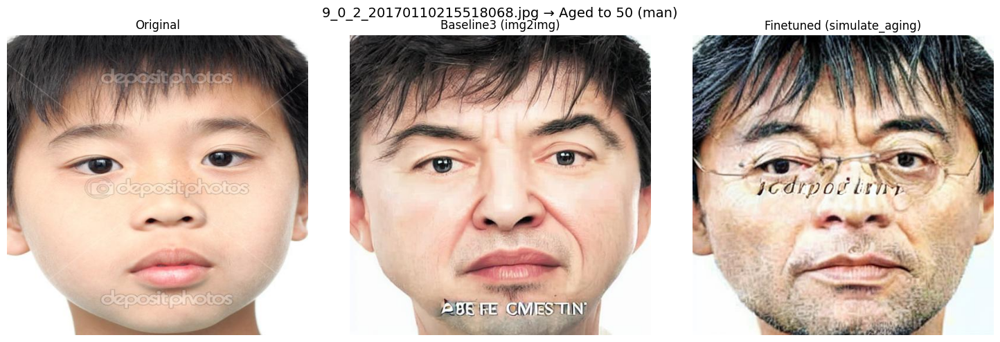

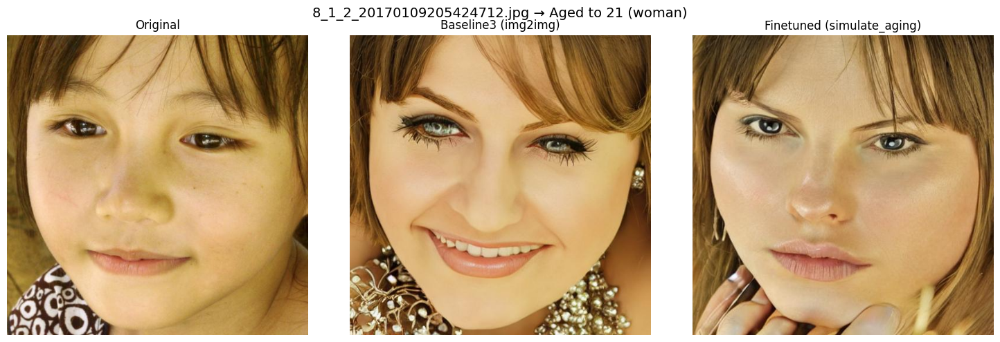

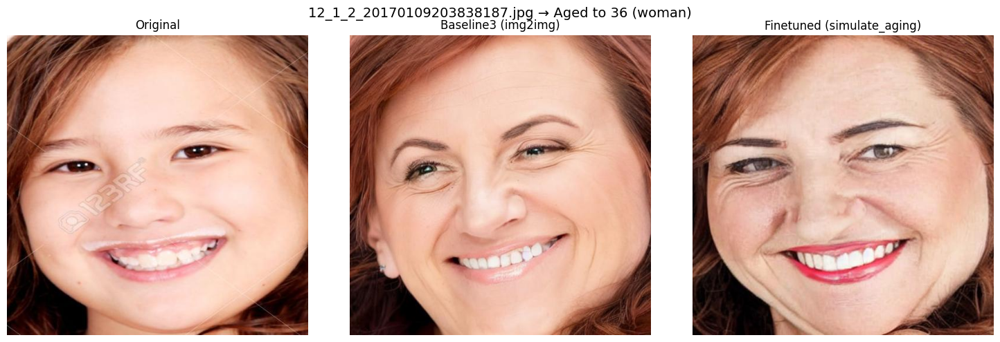

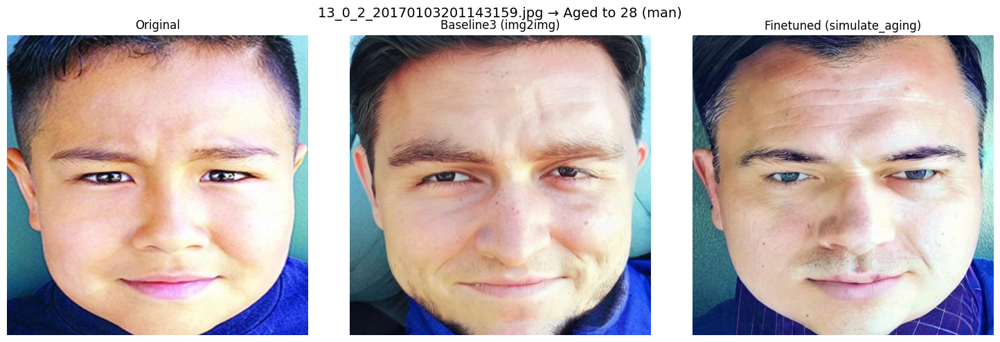

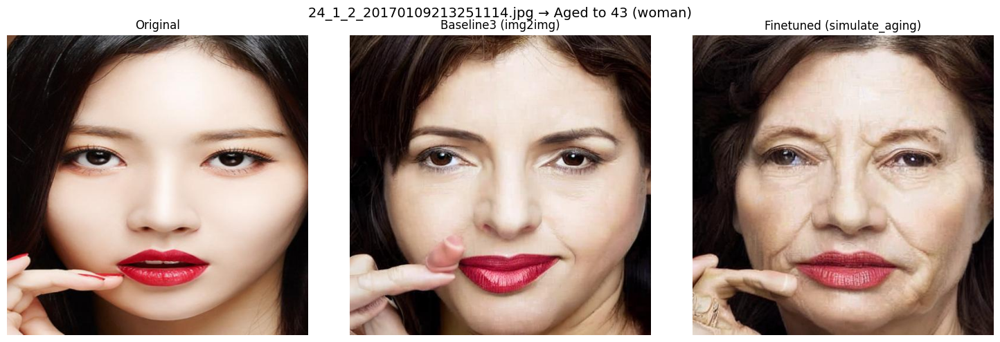

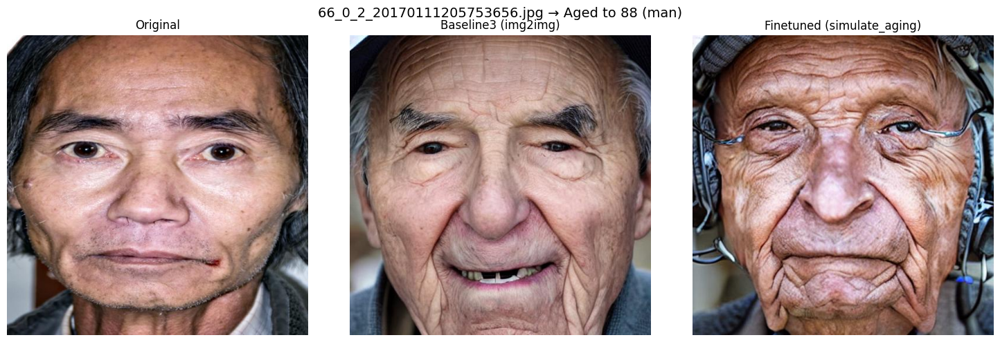

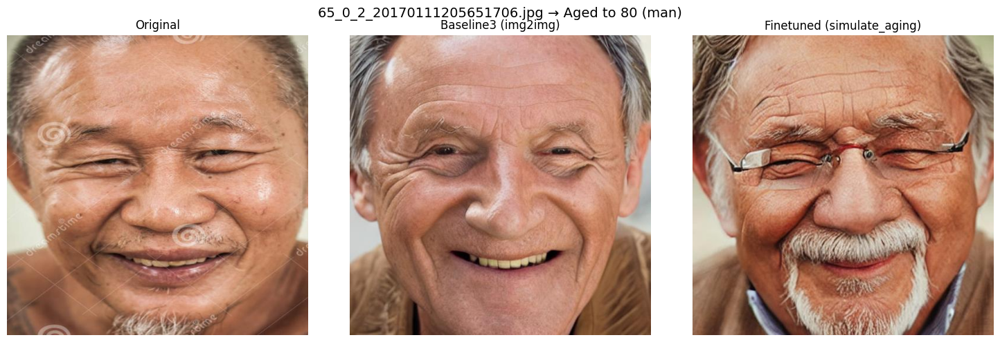

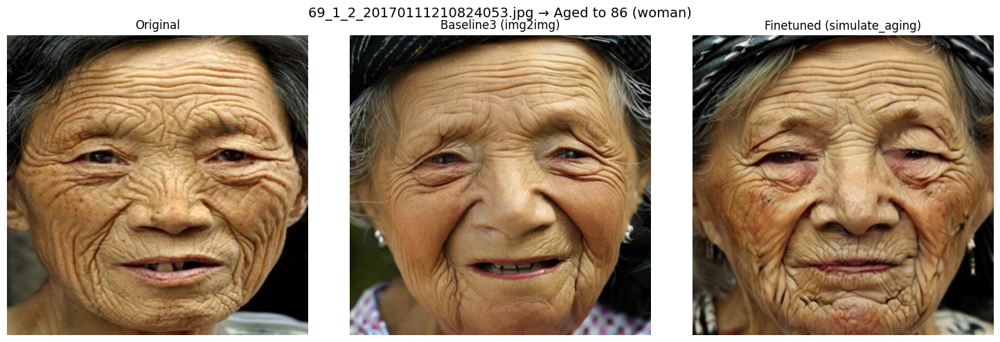

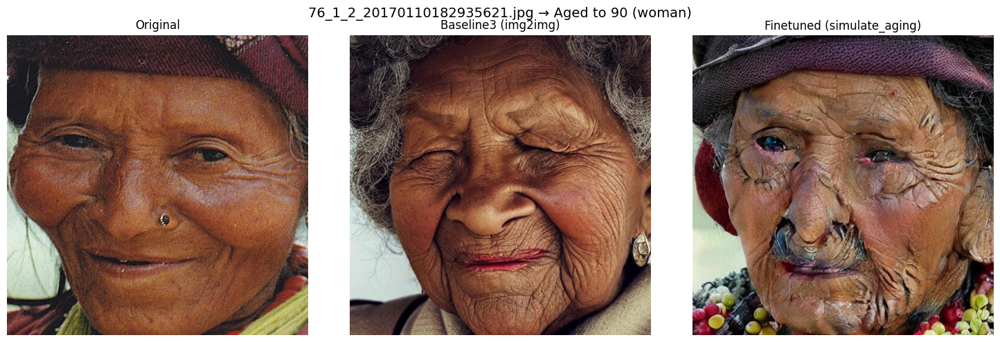

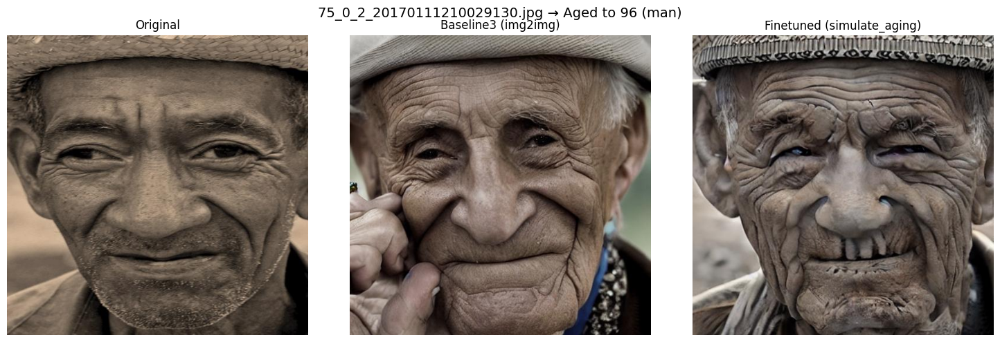

In [20]:
show_batch_images("outputs_part1.csv", max_images=10)


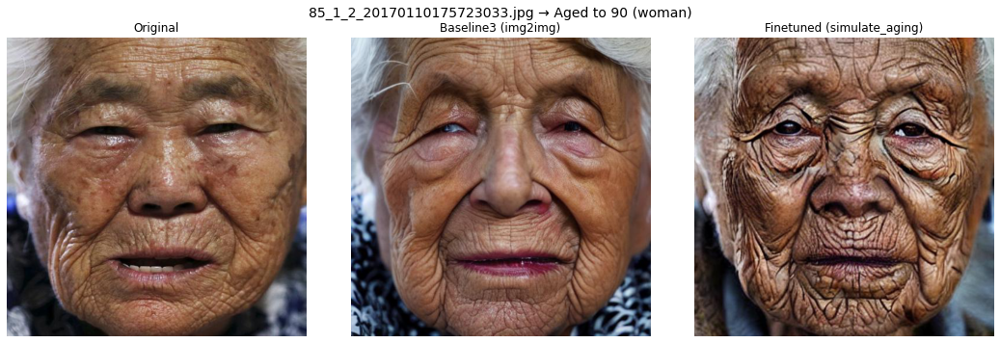

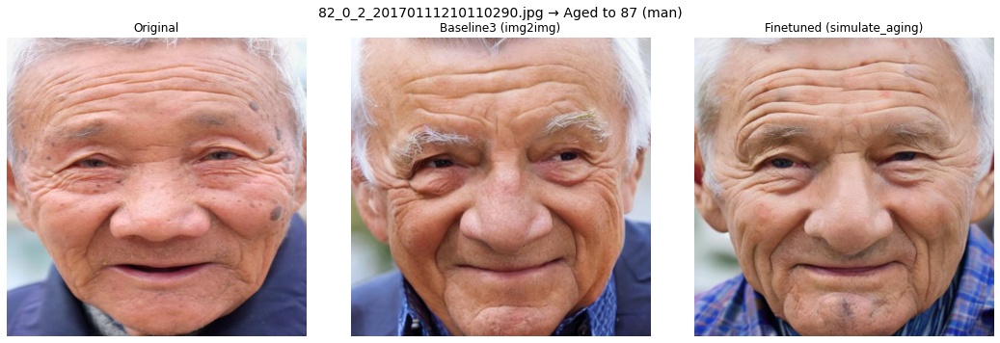

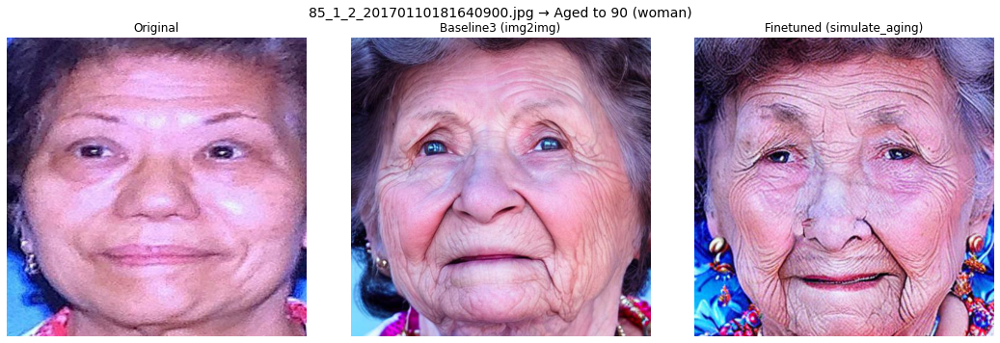

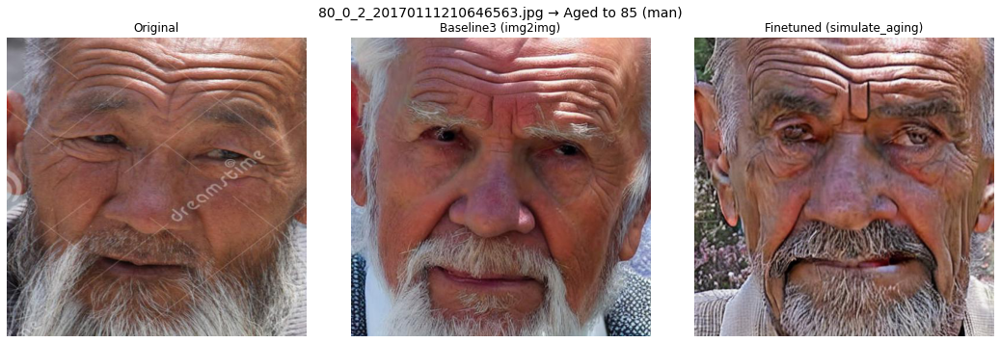

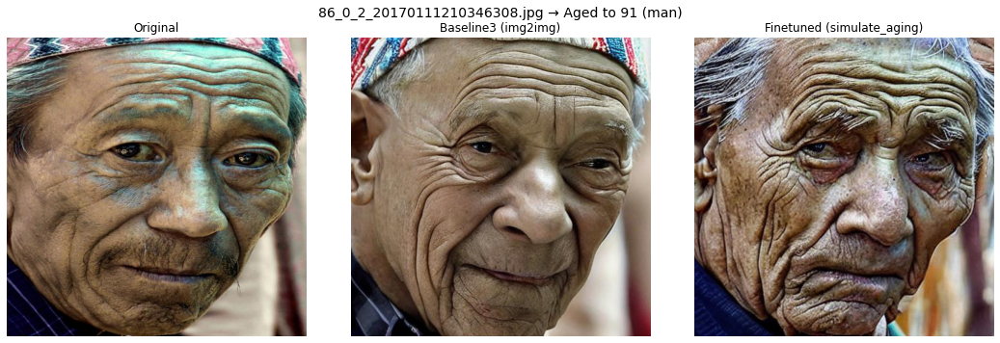

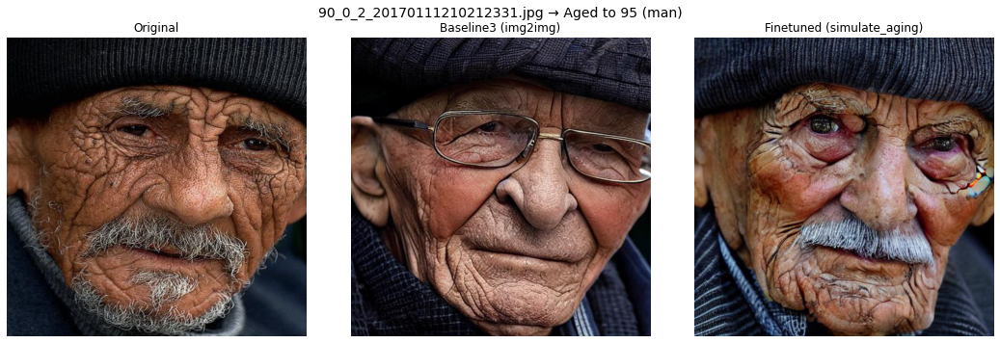

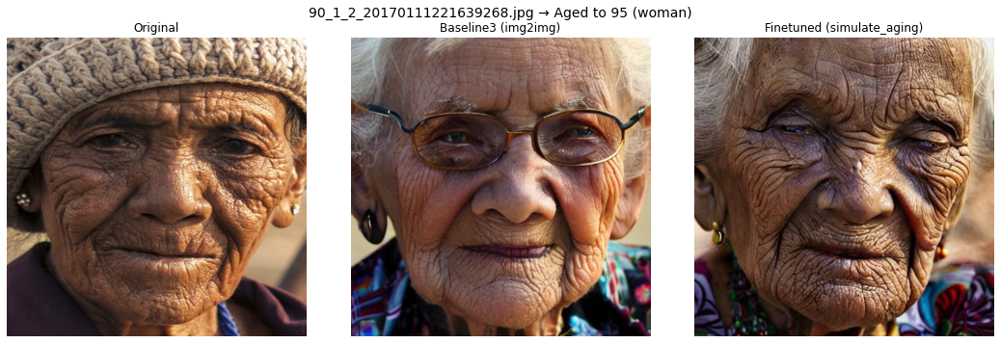

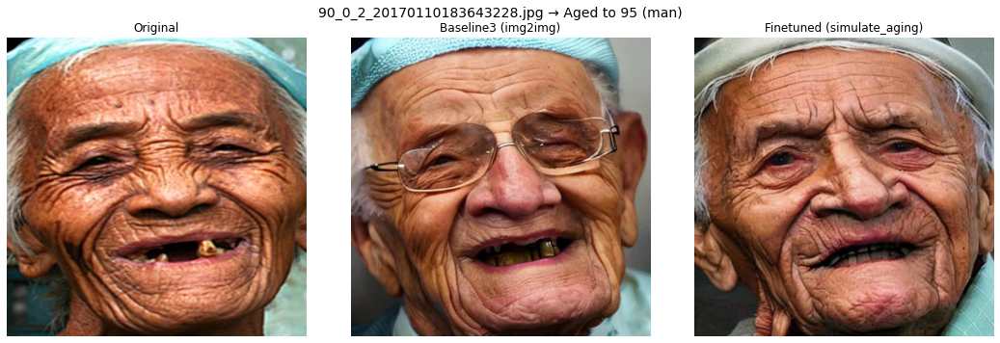

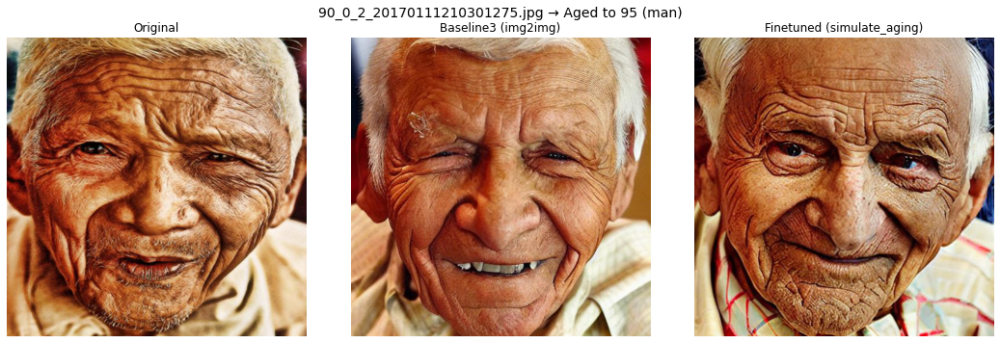

In [11]:
show_batch_images("outputs_part2.csv", max_images=10)

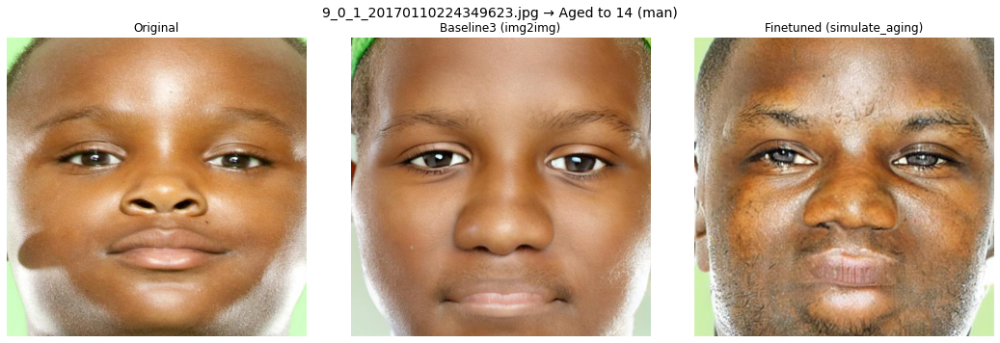

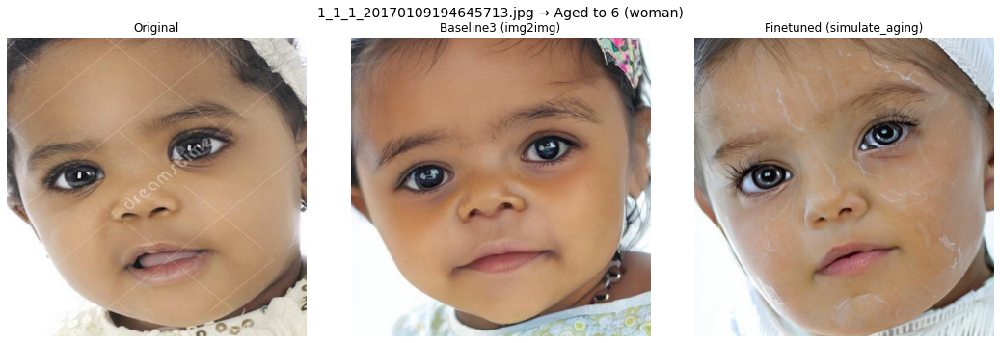

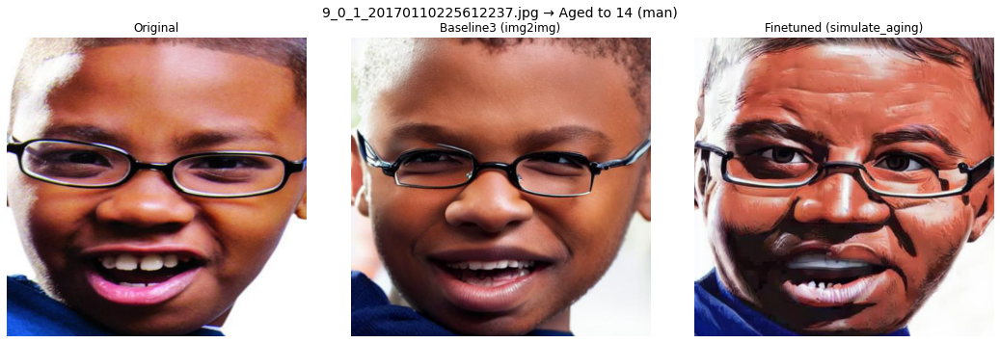

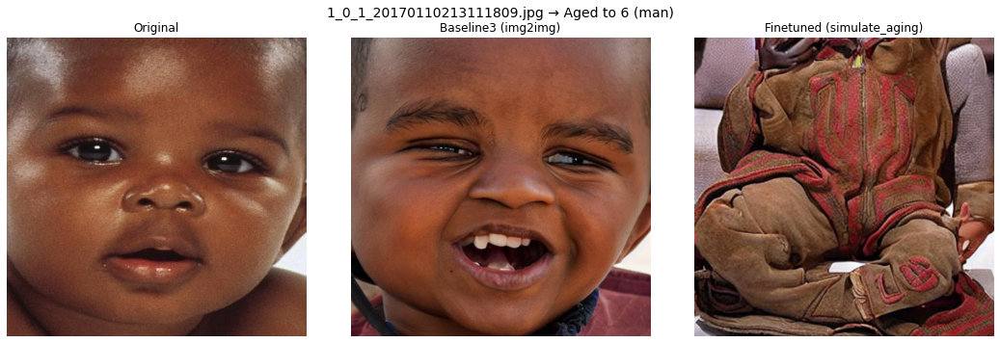

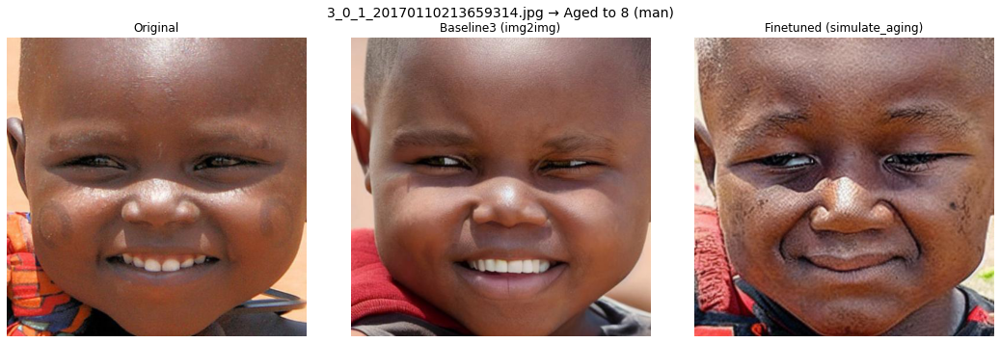

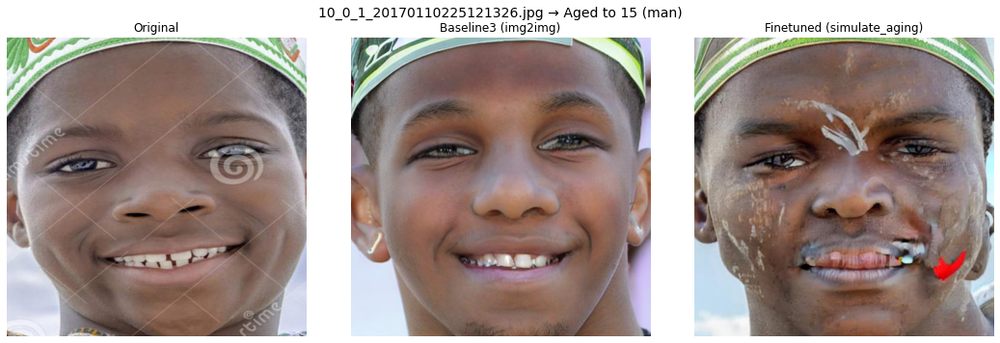

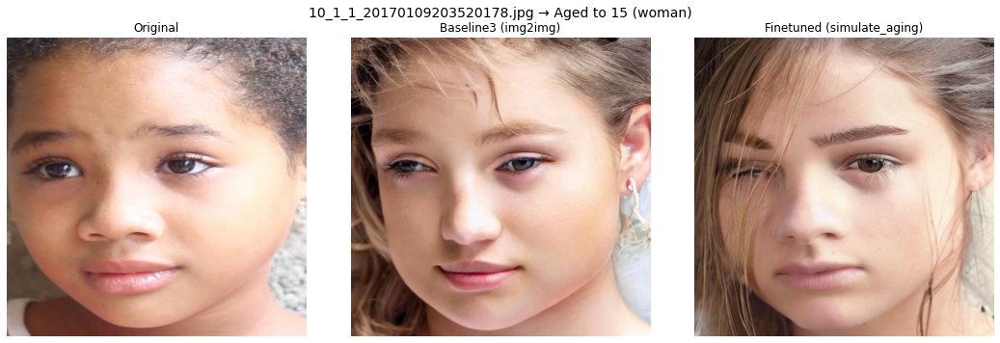

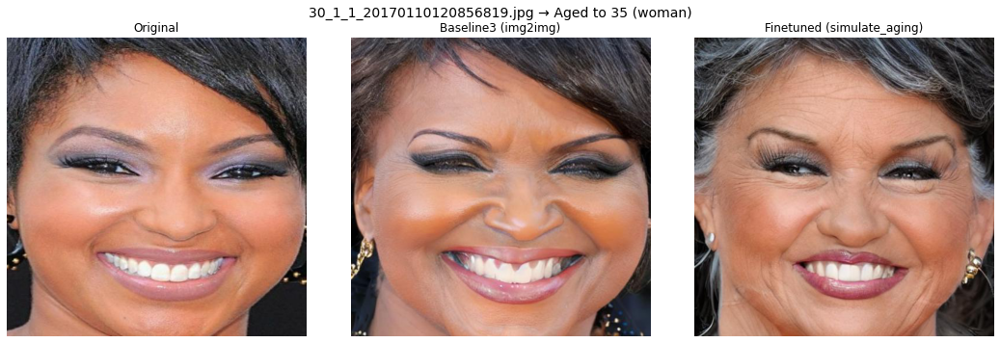

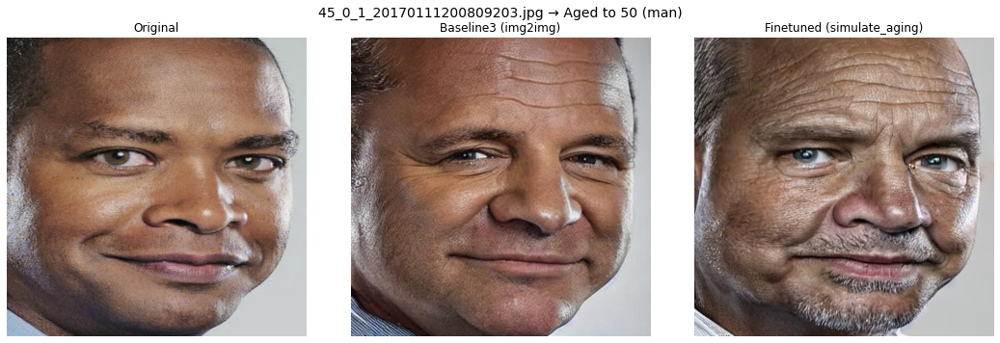

In [12]:
show_batch_images("outputs_part3.csv", max_images=10)

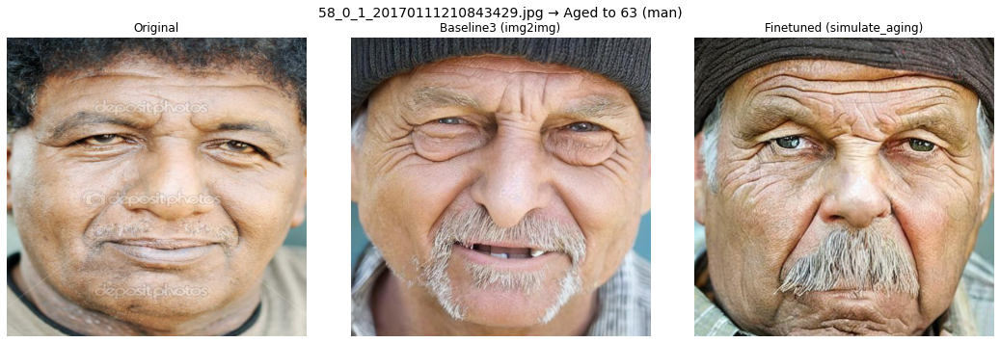

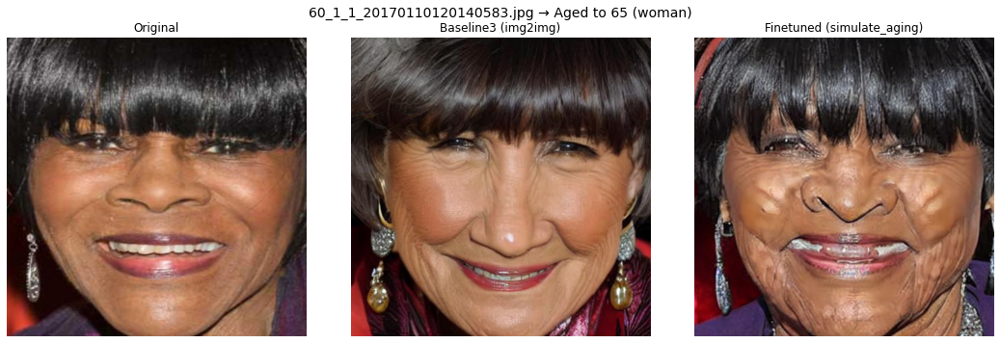

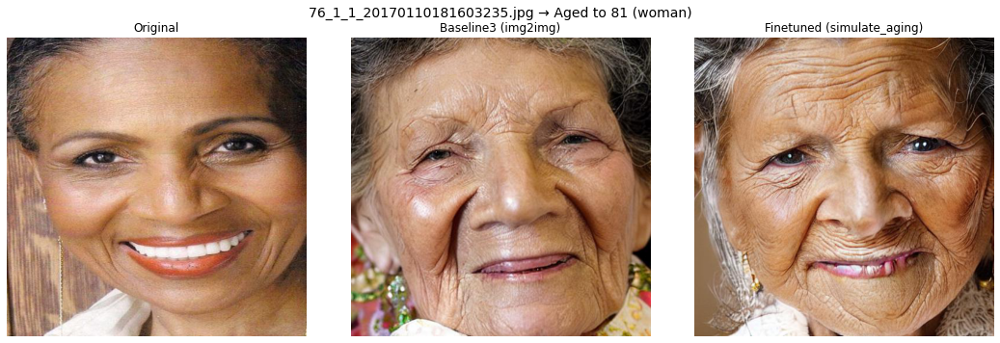

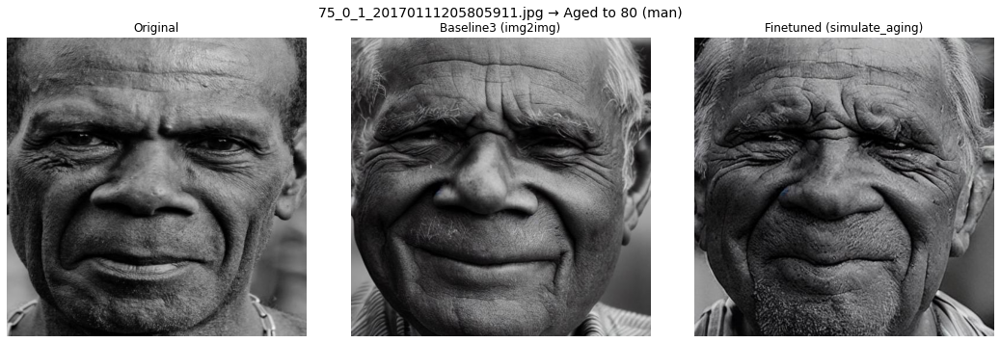

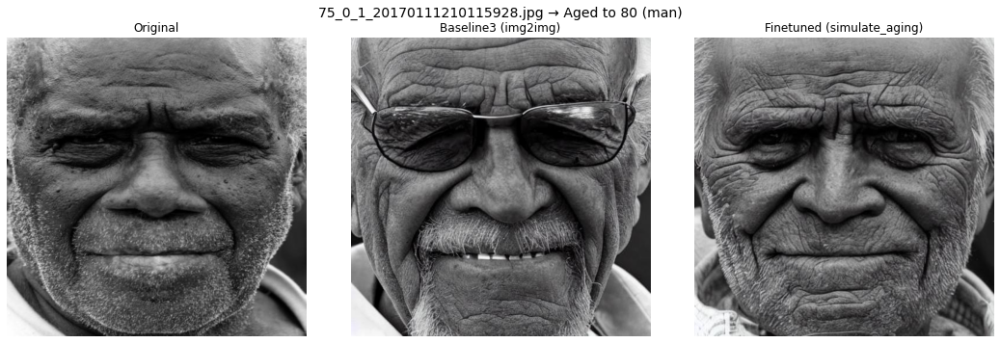

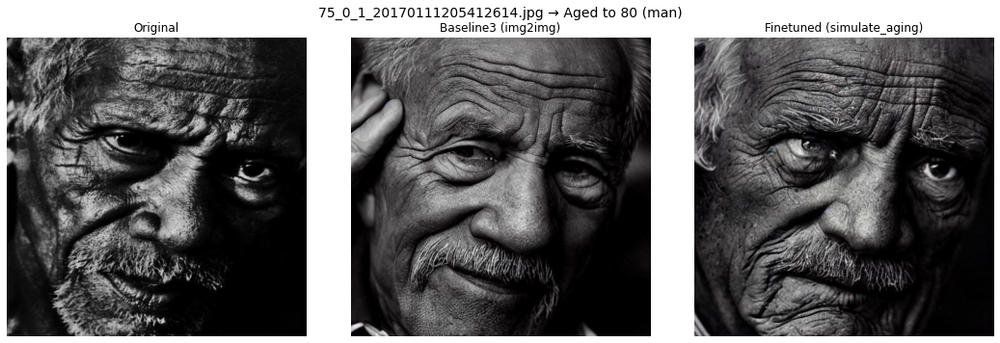

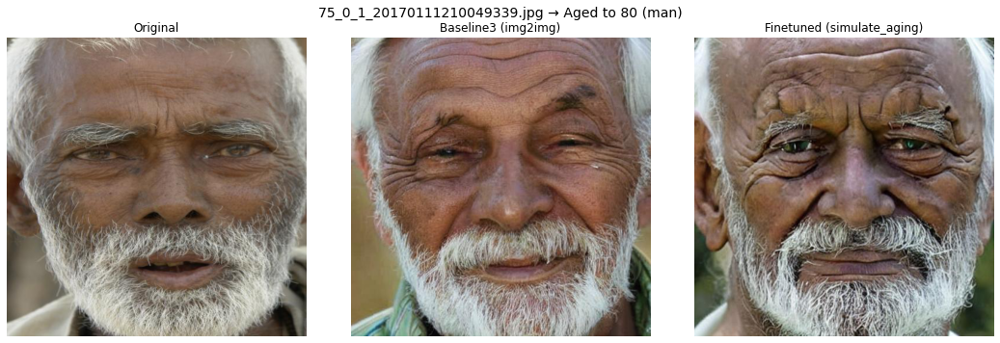

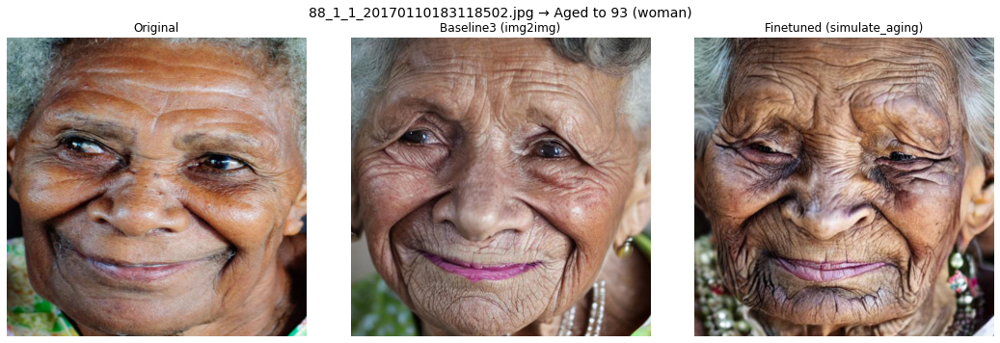

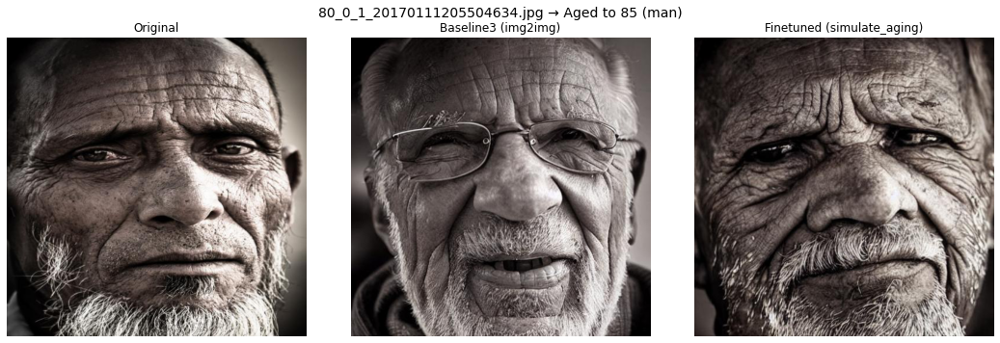

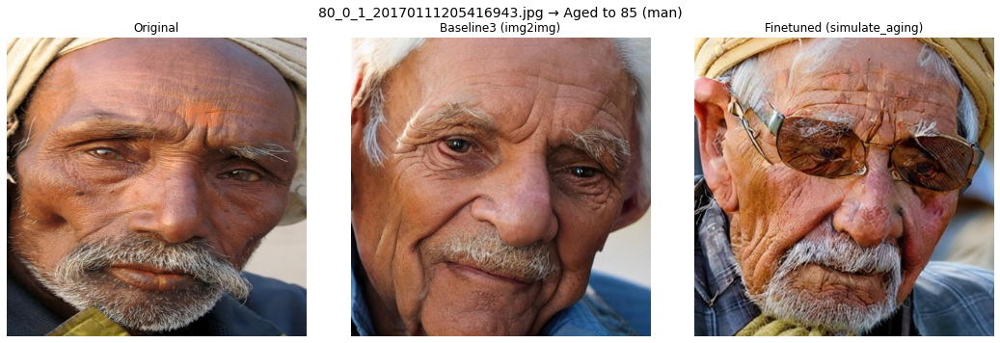

In [13]:
show_batch_images("outputs_part4.csv", max_images=10)